# Import Libraries

In [45]:
import tqdm

import numpy as np
import pandas as pd
import seaborn as sns
import xgboost as xgb
import lightgbm as lgb

import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go

from catboost import CatBoostRegressor

from plotly.subplots import make_subplots
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split, TimeSeriesSplit, GridSearchCV
from statsmodels.tsa.seasonal import seasonal_decompose

# Load Data

In [2]:
df = pd.read_csv('/kaggle/input/hourly-energy-consumption/PJME_hourly.csv')
df.head(5)

,Datetime,PJME_MW
0,2002-12-31 01:00:00,26498.0
1,2002-12-31 02:00:00,25147.0
2,2002-12-31 03:00:00,24574.0
3,2002-12-31 04:00:00,24393.0
4,2002-12-31 05:00:00,24860.0


In [3]:
def set_datetime(df):
    # Convert the 'Datetime' column to datetime format
    df = df.set_index('Datetime')

    # Sort by datetime
    df.sort_values('Datetime', inplace=True, ascending=True)

    df.index = pd.to_datetime(df.index)
    
    return df

df = set_datetime(df)
df.head()

,PJME_MW
Datetime,
2002-01-01 01:00:00,30393.0
2002-01-01 02:00:00,29265.0
2002-01-01 03:00:00,28357.0
2002-01-01 04:00:00,27899.0
2002-01-01 05:00:00,28057.0


## Lag Features

In [4]:
def add_lags(df):
    target_map = df['PJME_MW'].to_dict()
    df['lag1'] = (df.index - pd.Timedelta('364 days')).map(target_map)
    df['lag2'] = (df.index - pd.Timedelta('728 days')).map(target_map)
    df['lag3'] = (df.index - pd.Timedelta('1092 days')).map(target_map)
    return df

df = add_lags(df)

df.tail()

,PJME_MW,lag1,lag2,lag3
Datetime,,,,
2018-08-02 20:00:00,44057.0,42256.0,41485.0,38804.0
2018-08-02 21:00:00,43256.0,41210.0,40249.0,38748.0
2018-08-02 22:00:00,41552.0,39525.0,38698.0,37330.0
2018-08-02 23:00:00,38500.0,36490.0,35406.0,34552.0
2018-08-03 00:00:00,35486.0,33539.0,32094.0,31695.0


# Exploratory Data Analysis (EDA)

In [5]:
# Show the first few rows of the data
print(df.head())

# Show the statistical summary of the data
print(df.describe())

                     PJME_MW  lag1  lag2  lag3
Datetime                                      
2002-01-01 01:00:00  30393.0   NaN   NaN   NaN
2002-01-01 02:00:00  29265.0   NaN   NaN   NaN
2002-01-01 03:00:00  28357.0   NaN   NaN   NaN
2002-01-01 04:00:00  27899.0   NaN   NaN   NaN
2002-01-01 05:00:00  28057.0   NaN   NaN   NaN
             PJME_MW           lag1           lag2           lag3
count  145366.000000  136623.000000  127881.000000  119141.000000
mean    32080.222831   32138.008366   32209.894503   32321.059299
std      6464.012166    6485.483760    6471.073642    6460.150318
min     14544.000000   14544.000000   14544.000000   14544.000000
25%     27573.000000   27619.000000   27699.000000   27816.000000
50%     31421.000000   31485.000000   31583.000000   31717.000000
75%     35650.000000   35707.000000   35788.000000   35884.000000
max     62009.000000   62009.000000   62009.000000   62009.000000


In [6]:
# Plot the time series data
fig = px.line(df, x=df.index, y='PJME_MW', title='Hourly Energy Consumption Over Time')
fig.show()

In [7]:
# Plot the distribution of the energy consumption
fig = px.histogram(df, x='PJME_MW', nbins=50, title='Distribution of Hourly Energy Consumption')
fig.show()

In [8]:
# Hourly consumption patterns:
df['Hour'] = df.index.hour
fig = px.box(df, x='Hour', y='PJME_MW', title='Hourly Consumption Patterns')
fig.show()

In [9]:
# Daily consumption patterns:
df['DayOfWeek'] = df.index.dayofweek
fig = px.box(df, x='DayOfWeek', y='PJME_MW', title='Daily Consumption Patterns')
fig.show()

In [10]:
# Monthly consumption patterns:
df['Month'] = df.index.month
fig = px.box(df, x='Month', y='PJME_MW', title='Monthly Consumption Patterns')
fig.show()

In [11]:
# Yearly consumption patterns:
df['Year'] = df.index.year
fig = px.box(df, x='Year', y='PJME_MW', title='Yearly Consumption Patterns')
fig.show()

In [12]:
# Heatmap of hourly consumption:
hourly_avg = df.groupby(['DayOfWeek', 'Hour']).mean()['PJME_MW'].reset_index()
hourly_avg = hourly_avg.pivot('DayOfWeek', 'Hour', 'PJME_MW')
fig = px.imshow(hourly_avg, labels=dict(x="Hour of Day", y="Day of Week", color="Avg Consumption"),
                 x=list(range(24)), y=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
                 title='Average Hourly Consumption Heatmap')
fig.show()

/tmp/ipykernel_29/104145997.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.



In [13]:
# Scatter plot of lagged features versus target:
for i in range(3):
    fig = px.scatter(df, x=f'lag{i+1}', y='PJME_MW', title=f'Scatter Plot of Lag_{i+1} vs. Target')
    fig.show()

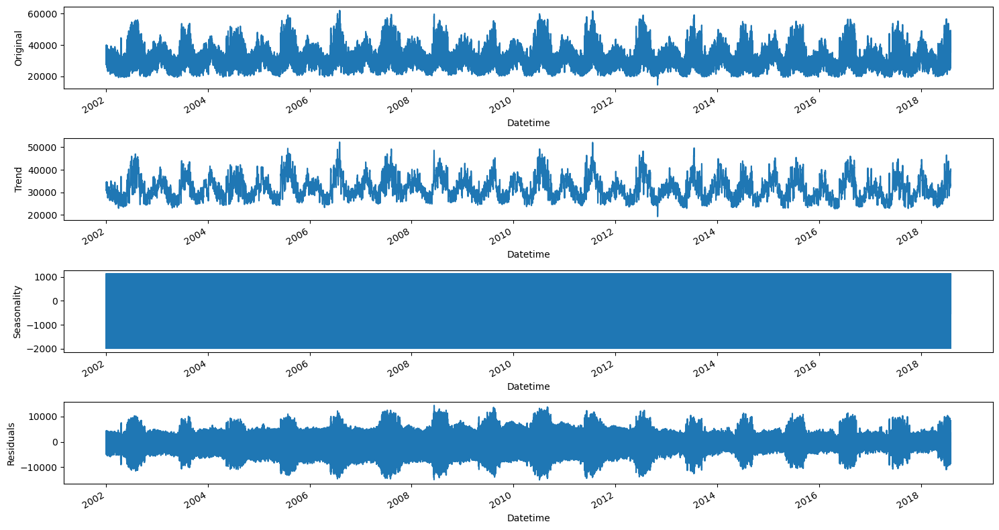

In [14]:
# Trend and seasonality decomposition:
decomposition = seasonal_decompose(df['PJME_MW'], model='additive', period=24)
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(15,8))
df['PJME_MW'].plot(ax=ax1)
ax1.set_ylabel('Original')
trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonality')
residual.plot(ax=ax4)
ax4.set_ylabel('Residuals')
plt.tight_layout()
plt.show()

# Data Preprocessing

## Outlier handlingOutlier Analysis and removal

In [15]:
color_pal = sns.color_palette()

<Axes: title={'center': 'Outliers'}, xlabel='Datetime'>

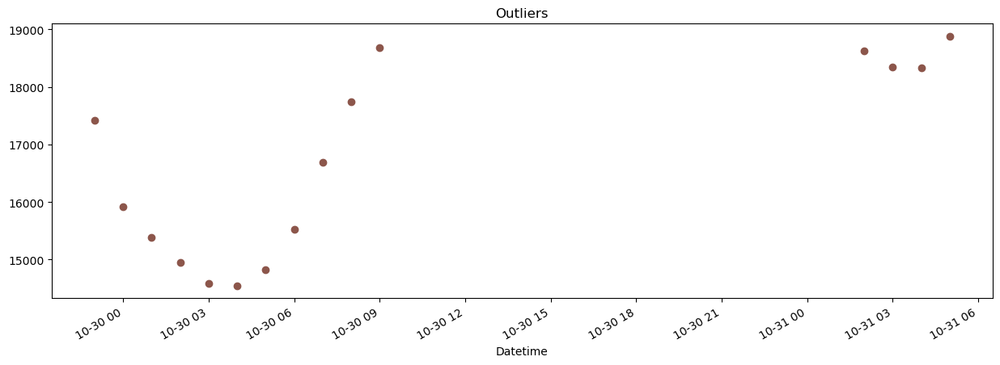

In [16]:
df.query('PJME_MW < 19_000')['PJME_MW'] \
    .plot(style='o',
          figsize=(15, 5),
          color=color_pal[5],
          title='Outliers')

In [17]:
df = df.query('PJME_MW > 19_000').copy()

## Train / Test Split

In [19]:
# Split the data
train = df.loc[df.index < '01-01-2015']
test = df.loc[df.index >= '01-01-2015']

# Create the plot
fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=train.index, y=train['PJME_MW'], mode='lines', name='Training Set'))
fig.add_trace(go.Scatter(x=test.index, y=test['PJME_MW'], mode='lines', name='Test Set'))

# Add vertical line with custom color and dash style
fig.add_trace(go.Scatter(
    x=['2015-01-01 00:00:00', '2015-01-01 00:00:00'], 
    y=[18_000, 61_000], 
    mode='lines', 
    name='Vertical Line',
    line=dict(color='black', dash='dash')
))

# Update layout
fig.update_layout(title='Data Train/Test Split', xaxis_title='Datetime', yaxis_title='PJME_MW')

fig.show()

In [20]:
# Filter the data
filtered_df = df.loc[(df.index > '01-01-2010') & (df.index < '01-08-2010')]

# Create the plot
fig = go.Figure()

# Add trace
fig.add_trace(go.Scatter(x=filtered_df.index, y=filtered_df['PJME_MW'], mode='lines', name='PJME_MW'))

# Update layout
fig.update_layout(title='Week Of Data', xaxis_title='Datetime', yaxis_title='PJME_MW')

fig.show()


## TimeSeries Cross Validation

In [21]:
tss = TimeSeriesSplit(n_splits=5, test_size=24*365*1, gap=24)
df = df.sort_index()

In [22]:
# Create subplots
fig = make_subplots(rows=5, cols=1, shared_xaxes=True, subplot_titles=[f'Data Train/Test Split Fold {i}' for i in range(5)])

# Create each fold
for i, (train_idx, val_idx) in enumerate(tss.split(df)):
    train = df.iloc[train_idx]
    test = df.iloc[val_idx]

    # Add training data trace
    fig.add_trace(
        go.Scatter(x=train.index, y=train['PJME_MW'], mode='lines', name='Training Set'),
        row=i+1, col=1
    )

    # Add test data trace
    fig.add_trace(
        go.Scatter(x=test.index, y=test['PJME_MW'], mode='lines', name='Test Set'),
        row=i+1, col=1
    )

    # Add vertical line at the beginning of test data
    fig.add_trace(
        go.Scatter(x=[test.index.min(), test.index.min()], y=[18_000, 61_000], 
                   mode='lines', name='Vertical Line', line=dict(color='black', dash='dash')), 
        row=i+1, col=1)

# Update layout
fig.update_layout(height=1200, width=800, title_text="Data Train/Test Split")

fig.show()

## Feature Creation

In [23]:
def create_features(df):
    """
    Create time series features based on time series index.
    """
    df = df.copy()
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    return df

In [24]:
df = pd.read_csv('/kaggle/input/hourly-energy-consumption/PJME_hourly.csv')

df = set_datetime(df)
df = create_features(df)
df = add_lags(df)

df.sample(5)

,PJME_MW,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,lag1,lag2,lag3
Datetime,,,,,,,,,,,,
2003-07-25 01:00:00,29972.0,1,4,3,7,2003,206,25,30,28071.0,NaN,NaN
2004-10-15 01:00:00,23868.0,1,4,4,10,2004,289,15,42,23734.0,23831.0,NaN
2012-11-09 14:00:00,30199.0,14,4,4,11,2012,314,9,45,31505.0,30767.0,32272.0
2006-05-13 20:00:00,27653.0,20,5,2,5,2006,133,13,19,29145.0,37828.0,26822.0
2003-07-03 05:00:00,26010.0,5,3,3,7,2003,184,3,27,32703.0,NaN,NaN


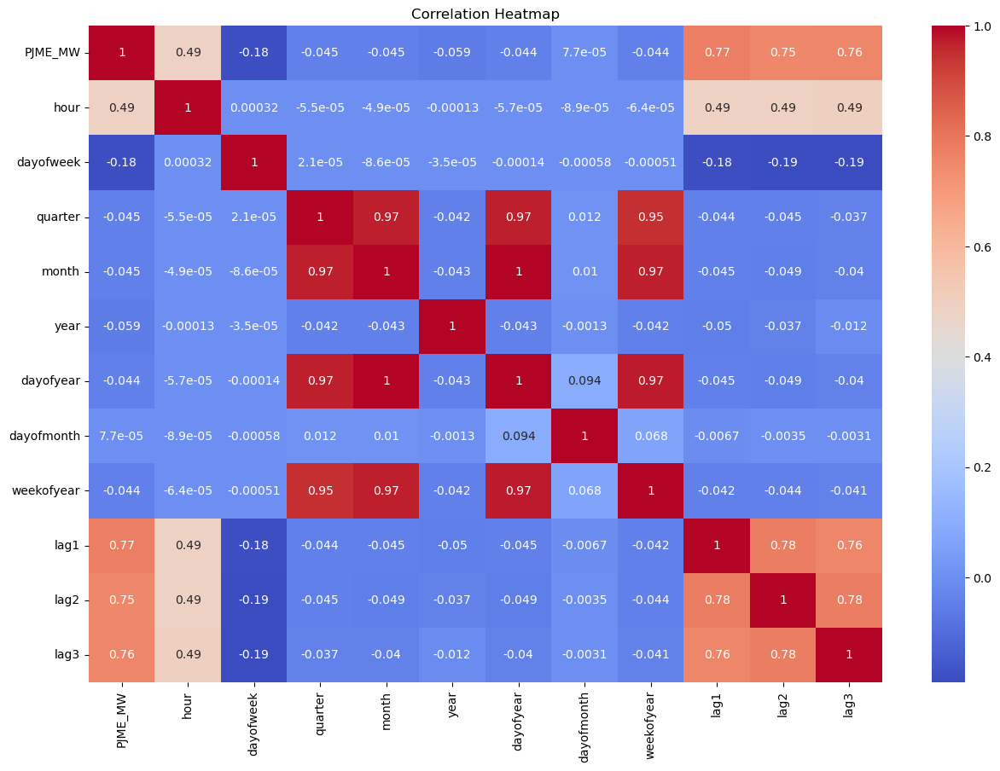

[CV 3/3; 1/6] END learning_rate=0.01, max_depth=3, n_estimators=500;, score=0.722 total time=  31.8s
[CV 2/3; 2/6] START learning_rate=0.01, max_depth=3, n_estimators=1000..........
[CV 2/3; 2/6] END learning_rate=0.01, max_depth=3, n_estimators=1000;, score=0.711 total time= 1.0min
[CV 1/3; 3/6] START learning_rate=0.1, max_depth=3, n_estimators=500............
[CV 1/3; 3/6] END learning_rate=0.1, max_depth=3, n_estimators=500;, score=0.381 total time=  34.8s
[CV 2/3; 3/6] START learning_rate=0.1, max_depth=3, n_estimators=500............
[CV 2/3; 3/6] END learning_rate=0.1, max_depth=3, n_estimators=500;, score=0.709 total time=  30.7s
[CV 1/3; 4/6] START learning_rate=0.1, max_depth=3, n_estimators=1000...........
[CV 1/3; 4/6] END learning_rate=0.1, max_depth=3, n_estimators=1000;, score=0.489 total time= 1.1min
[CV 3/3; 4/6] START learning_rate=0.1, max_depth=3, n_estimators=1000...........
[CV 3/3; 4/6] END learning_rate=0.1, max_depth=3, n_estimators=1000;, score=0.663 total tim

In [56]:
# Correlation heatmap:
corr = df.corr()
plt.figure(figsize=(15,10))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# Build Models

In [50]:
from tqdm import tqdm

def run_models(model, model_parameters):
    preds = []
    scores = []

    for train_idx, val_idx in tqdm(list(tss.split(df)), desc='Fitting models'):
        train = df.iloc[train_idx]
        test = df.iloc[val_idx]

        train = create_features(train)
        test = create_features(test)

        FEATURES = ['dayofyear', 'hour', 'dayofweek', 'quarter', 'month','year','lag1','lag2','lag3']
        TARGET = 'PJME_MW'

        X_train = train[FEATURES]
        y_train = train[TARGET]

        X_test = test[FEATURES]
        y_test = test[TARGET]
        
        # Create a GridSearchCV object
        model_grid = GridSearchCV(model, model_parameters, cv=3, verbose=100, n_jobs=-1)
        
        # Fit the GridSearchCV object
        model_grid.fit(X_train, y_train)

        # Predict using the best model
        y_pred = model_grid.best_estimator_.predict(X_test)
        preds.append(y_pred)
        score = np.sqrt(mean_squared_error(y_test, y_pred))
        scores.append(score)

    print(f'Score across folds {np.mean(scores):0.4f}')
    print(f'Fold scores:{scores}')

    return model_grid, preds, scores

## 1. XGBoost Regression

In [55]:
xgb_reg = xgb.XGBRegressor(early_stopping_rounds=50)
xgb_params = {
    'n_estimators': [500, 1000],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3]
}

xgb_grid, xgb_preds, xgb_scores = run_models(xgb.XGBRegressor(), xgb_params)

Fitting models:   0%|          | 0/5 [00:00<?, ?it/s]

Fitting 3 folds for each of 6 candidates, totalling 18 fits
[CV 2/3; 1/6] START depth=3, iterations=500, learning_rate=0.01.................
[CV 2/3; 1/6] END depth=3, iterations=500, learning_rate=0.01;, score=0.701 total time=  10.2s
[CV 1/3; 2/6] START depth=3, iterations=500, learning_rate=0.1..................
[CV 1/3; 2/6] END depth=3, iterations=500, learning_rate=0.1;, score=0.022 total time=   9.7s
[CV 3/3; 2/6] START depth=3, iterations=500, learning_rate=0.1..................
[CV 3/3; 2/6] END depth=3, iterations=500, learning_rate=0.1;, score=0.697 total time=   9.9s
[CV 2/3; 3/6] START depth=3, iterations=500, learning_rate=0.3..................
[CV 2/3; 3/6] END depth=3, iterations=500, learning_rate=0.3;, score=0.716 total time=   9.9s
[CV 1/3; 4/6] START depth=3, iterations=1000, learning_rate=0.01................
[CV 1/3; 4/6] END depth=3, iterations=1000, learning_rate=0.01;, score=-0.036 total time=  19.5s
[CV 3/3; 4/6] START depth=3, iterations=1000, learning_rate=0

Fitting models:  20%|██        | 1/5 [08:20<33:21, 500.41s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  40%|████      | 2/5 [17:20<26:11, 523.99s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  60%|██████    | 3/5 [26:57<18:15, 547.97s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  80%|████████  | 4/5 [37:15<09:35, 575.51s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models: 100%|██████████| 5/5 [47:34<00:00, 570.84s/it]

Score across folds 3875.1831
Fold scores:[3960.0348078493557, 3656.8563329449576, 3716.3955781352533, 3960.314213593616, 4082.314332948347]


## 2. LightGBM Regression

In [53]:
lgbm_reg = lgb.LGBMRegressor(early_stopping_rounds=50)
lgbm_params = {
    'n_estimators': [500, 1000],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3]
}

lgbm_grid, lgbm_preds, lgbm_scores = run_models(lgb.LGBMRegressor(), lgbm_params)

Fitting models:   0%|          | 0/5 [00:00<?, ?it/s]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
Fitting models:  20%|██        | 1/5 [01:07<04:28, 67.12s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  40%|████      | 2/5 [02:14<03:22, 67.40s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  60%|██████    | 3/5 [03:24<02:17, 68.53s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  80%|████████  | 4/5 [04:38<01:10, 70.77s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models: 100%|██████████| 5/5 [06:01<00:00, 72.25s/it]

Score across folds 3910.5803
Fold scores:[3986.5834915614887, 3634.24913812079, 3939.1529717865064, 3897.639554631327, 4095.276396860506]


## 3. CatBoost Regression

In [54]:
cat_reg = CatBoostRegressor(early_stopping_rounds=50)
cat_params = {
    'iterations': [500, 1000],
    'learning_rate': [0.01, 0.1, 0.3],
    'depth': [3]
}

cat_grid, cat_preds, cat_scores = run_models(CatBoostRegressor(verbose=0), cat_params)

Fitting models:   0%|          | 0/5 [00:00<?, ?it/s]

Fitting 3 folds for each of 6 candidates, totalling 18 fits
[CV 2/3; 1/6] START learning_rate=0.01, max_depth=3, n_estimators=500...........
[CV 2/3; 1/6] END learning_rate=0.01, max_depth=3, n_estimators=500;, score=0.712 total time=   4.2s
[CV 3/3; 1/6] START learning_rate=0.01, max_depth=3, n_estimators=500...........
[CV 3/3; 1/6] END learning_rate=0.01, max_depth=3, n_estimators=500;, score=0.723 total time=   4.2s
[CV 2/3; 2/6] START learning_rate=0.01, max_depth=3, n_estimators=1000..........
[CV 2/3; 2/6] END learning_rate=0.01, max_depth=3, n_estimators=1000;, score=0.712 total time=   8.4s
[CV 1/3; 3/6] START learning_rate=0.1, max_depth=3, n_estimators=500............
[CV 1/3; 3/6] END learning_rate=0.1, max_depth=3, n_estimators=500;, score=0.359 total time=   3.9s
[CV 2/3; 3/6] START learning_rate=0.1, max_depth=3, n_estimators=500............
[CV 2/3; 3/6] END learning_rate=0.1, max_depth=3, n_estimators=500;, score=0.718 total time=   3.8s
[CV 1/3; 4/6] START learning_ra

Fitting models:  20%|██        | 1/5 [02:20<09:21, 140.40s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  40%|████      | 2/5 [04:48<07:14, 144.79s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  60%|██████    | 3/5 [07:20<04:56, 148.22s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models:  80%|████████  | 4/5 [10:05<02:34, 154.93s/it]

Fitting 3 folds for each of 6 candidates, totalling 18 fits


Fitting models: 100%|██████████| 5/5 [12:57<00:00, 155.58s/it]

Score across folds 4214.0914
Fold scores:[4439.754864952301, 3727.126505180621, 4567.865284989644, 4060.1268907809967, 4275.5832481750895]


# Predict the Future

In [58]:
df = create_features(df)

FEATURES = ['dayofyear', 'hour', 'dayofweek', 'quarter', 'month', 'year','lag1','lag2','lag3']
TARGET = 'PJME_MW'

X_all = df[FEATURES]
y_all = df[TARGET]

best_reg = xgb.XGBRegressor(base_score=0.5,
                       booster='gbtree',    
                       n_estimators=500,
                       objective='reg:linear',
                       max_depth=3,
                       learning_rate=0.01)
best_reg.fit(X_all, y_all,
        eval_set=[(X_all, y_all)],
        verbose=100)

[15:46:17] WARNING: ../src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:32402.65859
[100]	validation_0-rmse:12426.28053
[200]	validation_0-rmse:5751.94624
[300]	validation_0-rmse:3972.75300
[400]	validation_0-rmse:3573.05471
[499]	validation_0-rmse:3457.78460


XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=500, n_jobs=None, num_parallel_tree=None,
             objective='reg:linear', predictor=None, ...)

In [59]:
future = pd.date_range('2018-08-03','2019-08-01', freq='1h')
future_df = pd.DataFrame(index=future)
future_df['isFuture'] = True
df['isFuture'] = False
df_and_future = pd.concat([df, future_df])
df_and_future = create_features(df_and_future)
df_and_future = add_lags(df_and_future)

In [61]:
future_w_features = df_and_future.query('isFuture').copy()
future_w_features['pred'] = best_reg.predict(future_w_features[FEATURES])

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=future_w_features.index,  # replace with your x-axis data (usually time)
    y=future_w_features['pred'],  # replace with your y-axis data
    mode='lines+markers',
    marker=dict(size=1),
    line=dict(width=1),
    name='Predictions'
))

fig.update_layout(
    title='Future Predictions',
    xaxis=dict(
        title='Time',
    ),
    yaxis=dict(
        title='Value',
    ),
    autosize=False,
    width=1000,
    height=500,
    plot_bgcolor='rgba(0,0,0,0)',
    paper_bgcolor='rgba(0,0,0,0)'
)

fig.show()

# Feature Importance

In [64]:
fi = pd.DataFrame(data=best_reg.feature_importances_, 
                  index=best_reg.feature_names_in_, 
                  columns=['importance'])
fi = fi.sort_values('importance')

fig = px.bar(fi, y=fi.index, x='importance', orientation='h', title='Feature Importance')
fig.show()